# 正規分布

In [1]:
import math
import numpy as np
import matplotlib.pyplot as plt

#正規分布を表示
def normal_distribution(x,mu,sigma):
    y = 1/np.sqrt(2*np.pi*sigma**2)*np.exp(-(x-mu)**2/(2*sigma**2))
    return y

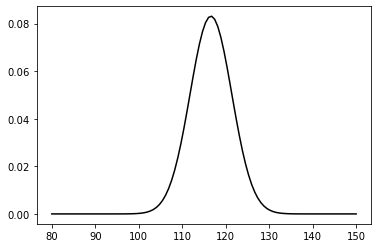

In [2]:
#正規分布のパラメータ設定
mu = 116.6
sigma = 4.8

#描画パラメータ設定
x_min = 80
x_max = 150
x_num = 100

#正規分布の計算
x = np.linspace(x_min, x_max, x_num)
y = normal_distribution(x,mu,sigma)

#正規分布の描画
plt.plot(x, y, color="k")
plt.show()
%matplotlib inline

In [3]:
#積分範囲の設定
x_min = 115
x_max = 117
x_num = 100

#積分範囲における正規分布の値の計算
x = np.linspace(x_min, x_max, x_num)
y = normal_distribution(x,mu,sigma)

#積分の計算
dx = (x_max-x_min)/(x_num-1)
prob = 0
for i in range(x_num):
    y = normal_distribution(x[i],mu,sigma)
    prob += y*dx
print("確率:",prob)    

確率: 0.1653959487393015


# テイラー展開

テイラー展開
21*x/10 + 21/10
テイラー展開
x**20/24329020081766400000 - x**19/135161222676480000 + x**18/64023737057280000 + x**17/323352207360000 + x**16/209227898880000 - x**15/1452971520000 + x**14/871782912000 + x**13/5660928000 + x**12/4790016000 - x**11/44352000 + x**10/36288000 + 11*x**9/3628800 + x**8/403200 - x**7/5600 + x**6/7200 + 11*x**5/1200 + x**4/240 - 3*x**3/20 + x**2/20 + 21*x/10 + 21/10


(0.0, 10.0)

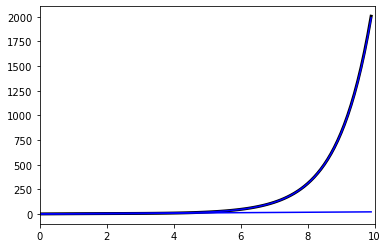

In [4]:
from sympy import *
import numpy as np
from matplotlib import pyplot as plt

#シンボルを定義
x = Symbol('x')

#関数を定義
f = 2 + x + sin(x) + exp(x)/10

#パラメータを設定
n1 = 1   #次数
n2 = 20  #次数
x0 = 0   #初期値

#テイター展開を導出1
taylor1 = series(f, x=x, x0=x0, n=n1+1).removeO()
taylor_y1 = lambdify(x, taylor1, 'numpy')
print("テイラー展開")
print(taylor1)

#テイター展開を導出2
taylor2 = series(f, x=x, x0=x0, n=n2+1).removeO()
taylor_y2 = lambdify(x, taylor2, 'numpy')
print("テイラー展開")
print(taylor2)

#描画
x_theory = np.arange(0.0, 10.0, 0.1)
y_theory = 2+x_theory+np.sin(x_theory)+np.exp(x_theory)/10
plt.plot(x_theory, y_theory, lw=3, c='k')
plt.plot(x_theory, taylor_y1(x_theory), c='b')
plt.plot(x_theory, taylor_y2(x_theory), c='b')
plt.xlim([0,10])

# 最急降下法

In [8]:
def func(x):
    y = x**2
    return y
    
def differential(x,dx):
    dy = (func(x+dx)-func(x))/dx
    return dy

In [9]:
import numpy as np
import matplotlib.pyplot  as plt
from matplotlib import animation, rc
from IPython.display import HTML

#関数生成
x_list = np.arange(-10, 11)
y_list = func(x_list)
num = len(x_list)

#パラメータ設定
dx = 0.1
iter = 200

#初期値設定
x = -10

#繰り返し処理
list_plot = []
fig = plt.figure()
for t in range(iter):
    #導関数を導出
    dy = differential(x,dx)
    #x、yを更新
    x = x - np.sign(dy)*dx
    y = func(x)
    #グラフを描画
    img = plt.plot(x,y,marker='.', color='red', markersize=20)
    img += plt.plot(x_list,y_list,color='black')
    list_plot.append(img)
    
#グラフ（アニメーション）描画
plt.grid()
anim = animation.ArtistAnimation(fig, list_plot, interval=200, repeat_delay=100)
rc('animation', html='jshtml')
plt.close()
anim

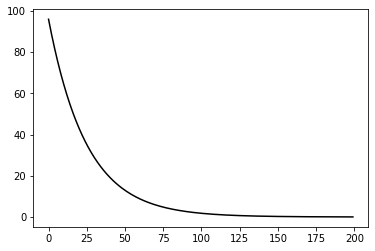

In [11]:
import numpy as np
import matplotlib.pyplot as plt

#パラメータ設定
delta = 0.01
iter = 200

#初期値設定
x = -10

#繰り返し処理
list_plot = []
series_y = []
fig = plt.figure()
for t in range(iter):
    #導関数を導出
    dy = differential(x,dx)
    #x、yを更新
    x = x - delta*dy
    y = func(x)
    series_y.append(y)
    
#グラフを描画
plt.plot(series_y, c='k')

In [12]:
def function(X,y,alpha,beta):
    cost = (1/(2*m))*np.sum((beta+alpha*X-y)**2)
    return cost

def differential_alpha(X,y,alpha,beta,delta):
    d_cost = (function(X,y,alpha+delta,beta)-function(X,y,alpha,beta))/delta
    return d_cost

def differential_beta(X,y,alpha,beta,delta):
    d_cost = (function(X,y,alpha,beta+delta)-function(X,y,alpha,beta))/delta
    return d_cost

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

#データ読み込み
df_sample = pd.read_csv("sample_linear.csv")
sample = df_sample.values.T

#変数を設定
X = sample[0]
y = sample[1]

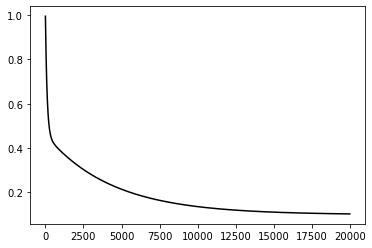

In [14]:
#パラメータ設定
delta = 0.001  #刻み幅（学習率）
iter = 20000   #繰り返し階数

#初期値設定
alpha = 1
beta = 1

#繰り返し処理
cost = np.zeros(iter)
da = np.zeros(iter)
m = len(y)
for i in range(iter):
    #導関数を導出
    d_alpha = differential_alpha(X,y,alpha,beta,delta)
    d_beta = differential_beta(X,y,alpha,beta,delta)
    
    #alpha、beta、costを更新
    alpha = alpha - delta*d_alpha
    beta = beta - delta*d_beta
    cost[i] = function(X,y,alpha,beta)
    da[i] = alpha
    
#グラフを描画
plt.plot(da, c='k')

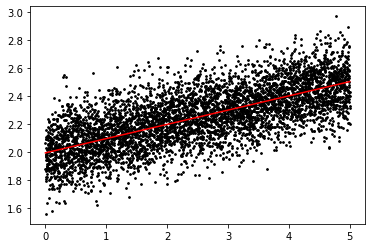

In [15]:
plt.scatter(sample[0],sample[1],c='k',s=3)
plt.plot(X,beta+alpha*X,color='red')
plt.show()

# 数値微分

数式の展開によって**解析的に**微分を求めると誤差が含まれず、真の微分を求めることができる。<br>
それに対して数値微分とは、**微小な差分**によって微分を求めることであり、僅かに誤差が生じる。

## 微分

$$\dfrac{df\left( x\right) }{dx}=\lim _{h\rightarrow 0}\dfrac{f\left( x+h\right)-f\left( x\right) }{h}$$

微分とは、ある瞬間の変化の量を表したもの。

In [16]:
def numerical_diff(f, x):
    h = 1e-50
    return (f(x+h) - f(x)) / h

これには２つの改善点がある。

### 丸め誤差（rounding error）

In [17]:
np.float32(1e-50)

0.0

丸め誤差とは、小数で小さすぎる値を用いることで、数値が省略され計算に誤差が生じること。<br>
$10^{-50}$の代わりに$10^{-4}$を用いることにする（この程度であれば良い結果が得られる）。

In [18]:
np.float32(1e-4)

1e-04

### 関数$f$の差分

$h$を無限に0へ近づけることができないため、真の微分とPython実装の値は一致しない。<br>
$(x+h)$と$x$の関数$f$の差分（**前方差分**）の代わりに$(x+h)$と$(x-h)$の差分（**中心差分**）を求め、誤差を小さくする。

### 改善した実装と例

In [19]:
def numerical_diff(f, x):
    h = 1e-4
    return (f(x+h) - f(x-h)) / (2*h)

$$y=0.01x^{2}+0.1x$$
$$\dfrac{dy}{dx}=0.02x+0.1$$

In [20]:
def function_1(x):
    return 0.01*x**2 + 0.1*x

In [21]:
numerical_diff(function_1, 5)

0.1999999999990898

In [22]:
numerical_diff(function_1, 10)

0.2999999999986347

真の値は、それぞれ0.2、0.3であるから、誤差を非常に小さく抑えられている。

0.1999999999990898
0.2999999999986347


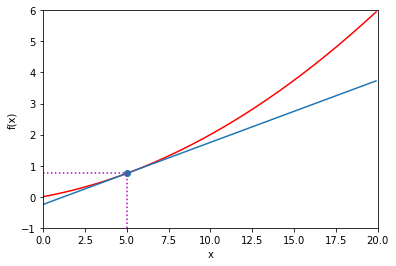

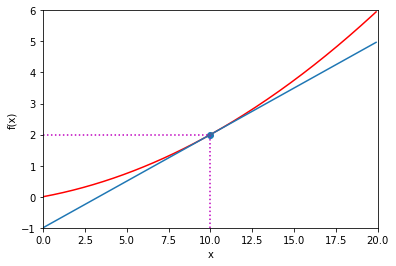

In [23]:
#グラフ描画
def tangent_line(f, x):
    d = numerical_diff(f, x)
    print(d)
    y = f(x) - d*x
    return lambda t: d*t + y
     
x = np.arange(0.0, 20.0, 0.1)
y = function_1(x)

tf2 = tangent_line(function_1, 5)
y2 = tf2(x)

tf3 = tangent_line(function_1, 10)
y3 = tf3(x)

plt.plot(x, y, color='red')
plt.plot(x, y2)
plt.scatter(5, 0.75)
plt.xlim(0,20)
plt.ylim(-1,6)
plt.xlabel("x")
plt.ylabel("f(x)")
plt.hlines(0.75,0,5, "m",linestyle=":")
plt.vlines(5,-1,0.75, "m", linestyle=":")
plt.show()

plt.plot(x, y, color='red')
plt.plot(x,y3)
plt.scatter(10, 2)
plt.xlim(0,20)
plt.ylim(-1,6)
plt.xlabel("x")
plt.ylabel("f(x)")
plt.hlines(2,0,10, "m",linestyle=":")
plt.vlines(10,-1,2, "m", linestyle=":")
plt.show()

## 偏微分

変数が複数あるため、どの変数に対する微分であるかを区別する必要がある。<br>
偏微分は、$\dfrac{\partial f}{\partial x_{0}}$、$\dfrac{\partial f}{\partial x_{1}}$のように表される。

$$f\left( x_{0},x_{1}\right) =x_{0}^{2}+x_{1}^{2}$$

In [24]:
def function_2(x):
    return x[0]**2 + x[1]**2

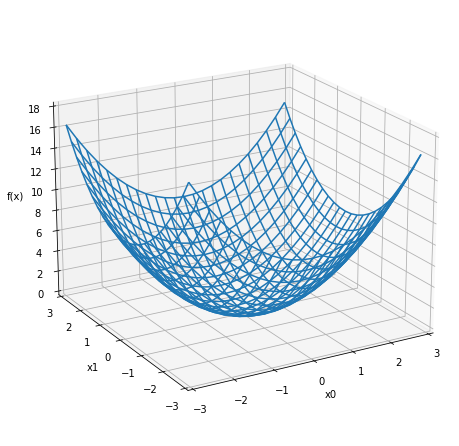

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize = (6, 6))
ax = Axes3D(fig)

X = np.arange(-3.0, 3.0, 0.25)
Y = np.arange(-3.0, 3.0, 0.25)

X, Y = np.meshgrid(X, Y)
Z = X ** 2 +Y ** 2

ax.set_xlabel("x0")
ax.set_ylabel("x1")
ax.set_zlabel("f(x)")

ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.set_zlim(0, 18)

ax.view_init(20, -120)

ax.plot_wireframe(X, Y, Z)

plt.show()

### 例題

$x_0=3$、$x_1=4$のときの$x_0$に対する偏微分と、$x_0$に対する偏微分をそれぞれ求めよ。

In [26]:
def function_tmp1(x0):
    return x0*x0 + 4.0**2.0

def function_tmp2(x1):
    return 3.0**2.0 + x1*x1

print(numerical_diff(function_tmp1, 3.0))
print(numerical_diff(function_tmp2, 4.0))

6.00000000000378
7.999999999999119


解析的な微分の解とほぼ一致する。

# 勾配

$\left( \dfrac{\partial f}{\partial x_{0}},\dfrac{\partial f}{\partial x_{1}}\right)$のように全ての変数の偏微分をベクトルとしてまとめたものを勾配という。

In [27]:
def numerical_gradient(f, x):
    h = 1e-4
    grad = np.zeros_like(x) #xと同じ形状の、要素が全て0の配列を生成
    
    for idx in range(x.size):
        tmp_val = x[idx]
        
        #f(x+h)の計算
        x[idx] = tmp_val + h
        fxh1=f(x)
        
        #f(x-h)の計算
        x[idx] = tmp_val - h
        fxh2=f(x)
        
        grad[idx] = (fxh1 - fxh2) / (2*h)
        x[idx] = tmp_val #値を元に戻す
    
    return grad

In [28]:
numerical_gradient(function_2, np.array([3.0, 4.0]))

array([6., 8.])

In [29]:
numerical_gradient(function_2, np.array([0.0, 2.0]))

array([0., 4.])

In [30]:
numerical_gradient(function_2, np.array([3.0, 0.0]))

array([6., 0.])

上記のように、$(x_0, x_1)$各点における勾配を得られる。<br>
なお、Numpy配列を出力するときは、数値が見やすように整形して出力される。

以下では、勾配の結果にマイナスを付けたベクトルを描画する。<br>
勾配が示す方向は、**各場所において関数の値を最も減らす**方向である。

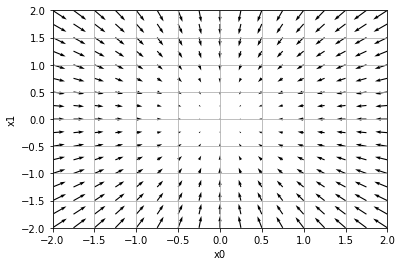

In [31]:
from mpl_toolkits.mplot3d import Axes3D


def _numerical_gradient_no_batch(f, x):
    h = 1e-4  # 0.0001
    grad = np.zeros_like(x)
    
    for idx in range(x.size):
        tmp_val = x[idx]
        x[idx] = float(tmp_val) + h
        fxh1 = f(x)  # f(x+h)
        
        x[idx] = tmp_val - h 
        fxh2 = f(x)  # f(x-h)
        grad[idx] = (fxh1 - fxh2) / (2*h)
        
        x[idx] = tmp_val  # 値を元に戻す
        
    return grad


def numerical_gradient(f, X):
    if X.ndim == 1:
        return _numerical_gradient_no_batch(f, X)
    else:
        grad = np.zeros_like(X)
        
        for idx, x in enumerate(X):
            grad[idx] = _numerical_gradient_no_batch(f, x)
        
        return grad


def function_2(x):
    if x.ndim == 1:
        return np.sum(x**2)
    else:
        return np.sum(x**2, axis=1)


def tangent_line(f, x):
    d = numerical_gradient(f, x)
    print(d)
    y = f(x) - d*x
    return lambda t: d*t + y


if __name__ == '__main__':
    x0 = np.arange(-2, 2.5, 0.25)
    x1 = np.arange(-2, 2.5, 0.25)
    X, Y = np.meshgrid(x0, x1)
    
    X = X.flatten()
    Y = Y.flatten()

    grad = numerical_gradient(function_2, np.array([X, Y]).T).T

    plt.figure()
    plt.quiver(X, Y, -grad[0], -grad[1],  angles="xy")
    plt.xlim([-2, 2])
    plt.ylim([-2, 2])
    plt.xlabel('x0')
    plt.ylabel('x1')
    plt.grid()
    plt.draw()
    plt.show()

# 勾配法

勾配によって見つけられるのは各地点においての関数の値を最も減らす方向である。<br>
複雑な損失関数について勾配を利用しても、最小値であるとは限らない（ほとんどの場合最小値でない）。<br><br>
そこで、現在位置から勾配方向に一定距離進み、関数の値を徐々に減らす**勾配法**を利用する。<br>
勾配法で探した場所も、最小値は限らず、極小値や鞍点（saddle point）である可能性はある。<br><br>
また関数が平らな形をしているところでは、「プラトー」と呼ばれる停滞期に陥ることがある。

$$x_{0}=x_{0}-\eta \dfrac{\partial f}{\partial x_{0}}$$

$$x_{1}=x_{1}-\eta \dfrac{\partial f}{\partial x_{1}}$$
$\eta$:学習率

これは、1回の更新式。学習率 $\eta$ はハイパーパラメータである。

In [32]:
def gradient_descent(f, init_x, lr=0.01, step_num=100):
    x = init_x
    
    for i in range(step_num):
        grad = numerical_gradient(f, x)
        x -= lr * grad
        
    return x

## 例題

$f\left( x_{0},x_{1}\right) =x_{0}^{2}+x_{1}^{2}$の最小値を勾配法で求める（正解:$(0, 0)$のとき$0$）

In [33]:
init_x = np.array([-3.0, 4.0])
gradient_descent(function_2, init_x=init_x, lr=0.1, step_num=100) #適切な学習率

array([-6.11110793e-10,  8.14814391e-10])

真の最小値$(0, 0)$に近く、ほぼ正確な結果が出力されている。

In [34]:
init_x = np.array([-3.0, 4.0])
gradient_descent(function_2, init_x=init_x, lr=10.0, step_num=100) #大きすぎる学習率

array([-2.58983747e+13, -1.29524862e+12])

大きな値に発散してしまう。

In [35]:
init_x = np.array([-3.0, 4.0])
gradient_descent(function_2, init_x=init_x, lr=1e-10, step_num=100) #適切な学習率

array([-2.99999994,  3.99999992])

値がほとんど更新されていない。

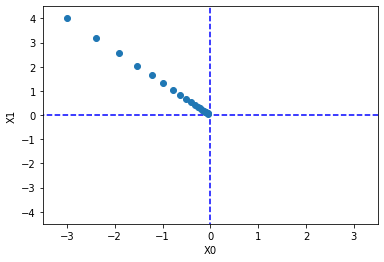

In [36]:
def gradient_descent(f, init_x, lr=0.01, step_num=100):
    x = init_x
    x_history = []

    for i in range(step_num):
        x_history.append( x.copy() )

        grad = numerical_gradient(f, x)
        x -= lr * grad

    return x, np.array(x_history)

init_x = np.array([-3.0, 4.0])    

lr = 0.1
step_num = 20
x, x_history = gradient_descent(function_2, init_x, lr=lr, step_num=step_num)

plt.plot( [-5, 5], [0,0], '--b')
plt.plot( [0,0], [-5, 5], '--b')
plt.plot(x_history[:,0], x_history[:,1], 'o')

plt.xlim(-3.5, 3.5)
plt.ylim(-4.5, 4.5)
plt.xlabel("X0")
plt.ylabel("X1")
plt.show()

初期値$(-3.0, 4.0)$から、最小値$(0, 0)$に向かっていっている。

## 学習率の違いの可視化

In [37]:
def func_1(x):
    y = 0.128*(x-1)**6 + 0.64*(x-1)**5 + 0.08*(x-1)**4 - 8/3*(x-1)**3 - 4/3*(x-1)**2 + 2*(x-1) + 0.5
    return y

def differential_1(x,dx):
    dy = (func_1(x+dx)-func_1(x))/dx
    return dy

In [38]:
#関数生成
x_list = np.arange(-2.5, 2.9, 0.02)
y_list = func_1(x_list)
num = len(x_list)

In [39]:
#初期値設定
x = -2.5

#パラメータ設定
dx = 0.02
iter = 270
lr = 1

#繰り返し処理
list_plot = []
fig = plt.figure()
for t in range(iter):
    #導関数を導出
    dy = differential_1(x,dx)
    #x、yを更新
    x = x - lr * np.sign(dy)*dx
    y = func_1(x)
    #グラフを描画
    img = plt.plot(x,y,marker='.', color='red', markersize=20)
    img += plt.plot(x_list,y_list,color='black')
    list_plot.append(img)
    
#グラフ（アニメーション）描画
plt.grid()
anim = animation.ArtistAnimation(fig, list_plot, interval=200, repeat_delay=100)
rc('animation', html='jshtml')
plt.close()
anim

学習率がやや小さいと、谷にはまって抜け出せなくなり、最小値を見つけられない。

In [40]:
#初期値設定
x = -2.5

#パラメータ設定
dx = 0.02
iter = 270
lr = 1e-2

#繰り返し処理
list_plot = []
fig = plt.figure()
for t in range(iter):
    #導関数を導出
    dy = differential_1(x,dx)
    #x、yを更新
    x = x - lr * np.sign(dy)*dx
    y = func_1(x)
    #グラフを描画
    img = plt.plot(x,y,marker='.', color='red', markersize=20)
    img += plt.plot(x_list,y_list,color='black')
    list_plot.append(img)
    
#グラフ（アニメーション）描画
plt.grid()
anim = animation.ArtistAnimation(fig, list_plot, interval=200, repeat_delay=100)
rc('animation', html='jshtml')
plt.close()
anim

学習率が小さすぎると、収束が遅くなる。

In [41]:
#初期値設定
x = -2.5

#パラメータ設定
dx = 0.02
iter = 270
lr = 97

#繰り返し処理
list_plot = []
fig = plt.figure()
for t in range(iter):
    #導関数を導出
    dy = differential_1(x,dx)
    #x、yを更新
    x = x - lr * np.sign(dy)*dx
    y = func_1(x)
    #グラフを描画
    img = plt.plot(x,y,marker='.', color='red', markersize=20)
    img += plt.plot(x_list,y_list,color='black')
    list_plot.append(img)
    
#グラフ（アニメーション）描画
plt.grid()
anim = animation.ArtistAnimation(fig, list_plot, interval=200, repeat_delay=100)
rc('animation', html='jshtml')
plt.close()
anim

適切な学習率で、最小値を大まかに捉えているようである。

In [42]:
#初期値設定
x = -2.5

#パラメータ設定
dx = 0.02
iter = 270
lr = 110

#繰り返し処理
list_plot = []
fig = plt.figure()
for t in range(iter):
    #導関数を導出
    dy = differential_1(x,dx)
    #x、yを更新
    x = x - lr * np.sign(dy)*dx
    y = func_1(x)
    #グラフを描画
    img = plt.plot(x,y,marker='.', color='red', markersize=20)
    img += plt.plot(x_list,y_list,color='black')
    list_plot.append(img)
    
#グラフ（アニメーション）描画
plt.grid()
anim = animation.ArtistAnimation(fig, list_plot, interval=200, repeat_delay=100)
rc('animation', html='jshtml')
plt.close()
anim

学習率が大きすぎると、最小値を細かく捉えられなくなったり、飛び越してしまう恐れがある。